In [1]:
import cv2
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import random
import shutil
import os

# DETECCION FACIAL CON TENSORFLOW

In [2]:
with tf.io.gfile.GFile('frozen_inference_graph_face.pb','rb') as f:
    graph_def = tf.compat.v1.GraphDef()
    graph_def.ParseFromString(f.read())

with tf.Graph().as_default() as mobilenet:
    tf.import_graph_def(graph_def,name='')

In [3]:
def detect_faces(image, score_threshold= 0.7):
    global boxes, scores
    (imh, imw) = image.shape[:-1]
    img = np.expand_dims(image,axis=0) # Agregar dimension a la imagen que requiere mobilenet
    
    # Inicializar mobilenet
    sess = tf.compat.v1.Session(graph=mobilenet)
    image_tensor = mobilenet.get_tensor_by_name('image_tensor:0')
    boxes = mobilenet.get_tensor_by_name('detection_boxes:0')
    scores = mobilenet.get_tensor_by_name('detection_scores:0')
    
    # Predicción (detección)
    (boxes, scores) = sess.run([boxes, scores], feed_dict={image_tensor:img})
    
    # Reajustar tamaños boxes, scores
    boxes = np.squeeze(boxes,axis=0)
    scores = np.squeeze(scores,axis=0)
    
    # Depurar bounding boxes
    idx = np.where(scores>=score_threshold)[0]
    
    # Crear bounding boxes
    bboxes = []
    for index in idx:
        ymin, xmin, ymax, xmax = boxes[index,:]
        (left, right, top, bottom) = (xmin*imw, xmax*imw, ymin*imh, ymax*imh)
        left, right, top, bottom = int(left), int(right), int(top), int(bottom)
        bboxes.append([left,right,top,bottom])
        
    return bboxes

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra.jpeg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra1.jpeg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra10.jpeg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra100.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra101.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra102.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra103.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra104.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra105.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\da

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra171.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra172.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra173.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra174.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra175.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra176.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra177.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra178.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra179.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra75.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra76.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra77.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra78.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra79.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra8.jpeg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra80.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra81.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\ibra82.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\database

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134853.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134853_1.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134854.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134855.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134902.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134903.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134904.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_134905.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\data

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153529.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153529_1.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153532.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153533.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153535.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153535_1.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153536.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\IBRA\IMG_20230519_153539.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\da

C:\Users\Ruben Martinez\AppData\Local\Temp\ipykernel_41560\3557154653.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


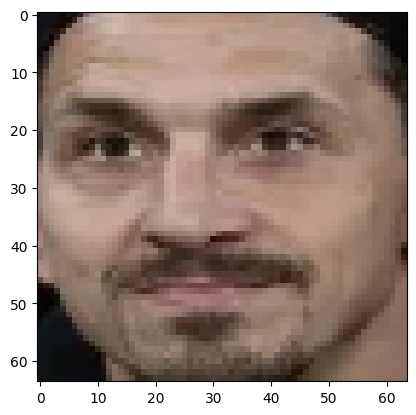

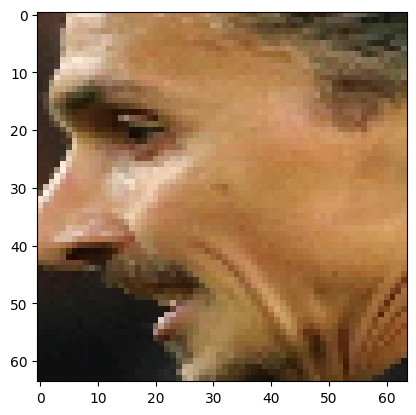

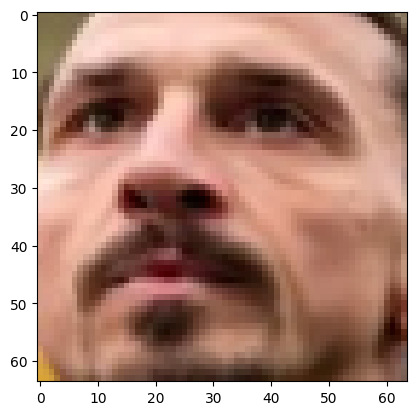

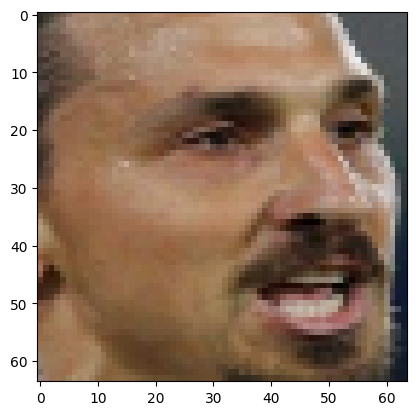

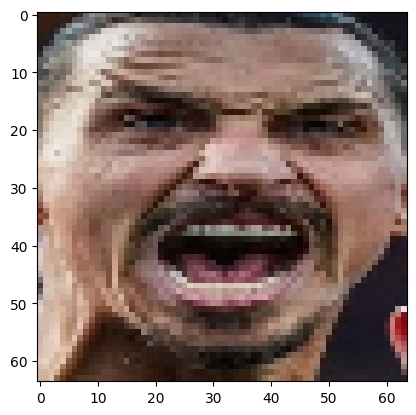

...

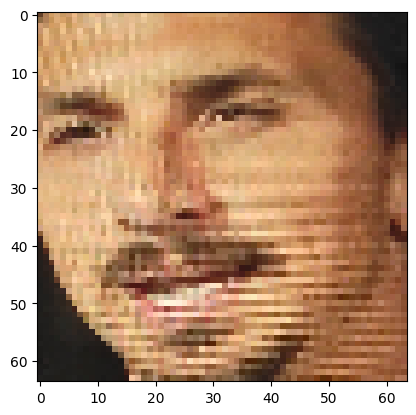

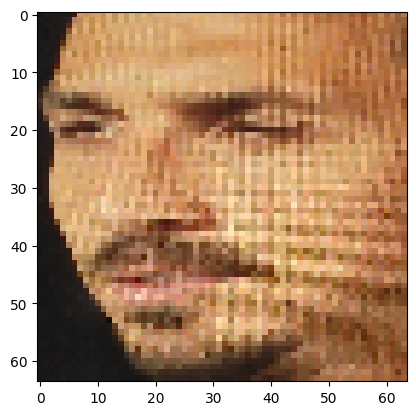

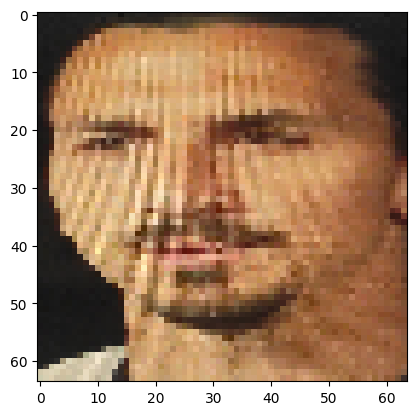

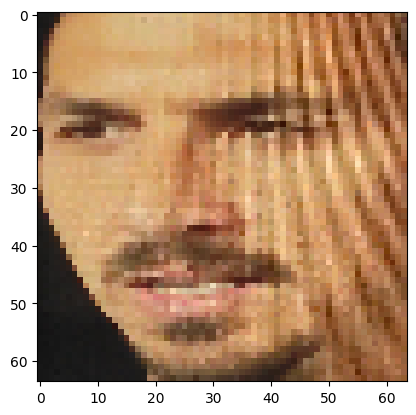

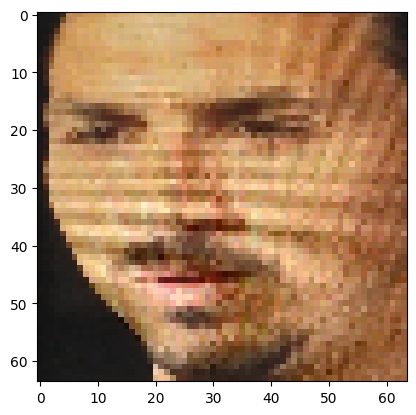

In [5]:
path = 'databaseCNN/IBRA/'
images = os.listdir(path)

cut_faces_list = []

for image_path in images:
    # Obtener la ruta absoluta de la imagen
    abs_image_path = os.path.abspath(os.path.join(path, image_path))
    print(f'Cargando imagen: {abs_image_path}')

    # Cargar la imagen y detectar rostros
    image = cv2.cvtColor(cv2.imread(abs_image_path), cv2.COLOR_BGR2RGB)
    boxes = detect_faces(image)

    cut_faces = []
    for box in boxes:
        left, right, top, bottom = box
        face = image[top:bottom, left:right]
        cut_faces.append(cv2.resize(face,dsize=(64,64)))
    
    cut_faces_list.extend(cut_faces)

# Mostrar las imágenes recortadas
for i in range(len(cut_faces_list)):
    plt.figure(i)
    plt.imshow(cut_faces_list[i])

In [8]:
# Crea la carpeta IBRA_CUT si no existe
if not os.path.exists('IBRA_CUT'):
    os.makedirs('IBRA_CUT')

# Guarda cada imagen en la carpeta IBRA_CUT
for i, cut_face in enumerate(cut_faces_list):
    # Guardar la imagen original
    filename = f'IBRA_CUT/Ibra_{i}.jpg'
    cv2.imwrite(filename, cv2.cvtColor(cut_face, cv2.COLOR_RGB2BGR))
    
    # Voltear horizontalmente la imagen y guardarla
    flipped_face = cv2.flip(cut_face, 1)
    filename_flipped = f'IBRA_CUT/Ibra_{i}_flipped.jpg'
    cv2.imwrite(filename_flipped, cv2.cvtColor(flipped_face, cv2.COLOR_RGB2BGR))

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\100692_1954-12-28_2000.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1007192_1935-05-27_2005.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\10123192_1971-04-29_2014.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1020882_1985-12-03_2009.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1023592_1937-02-21_2009.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\102592_1961-01-13_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\102994_1950-09-21_2014.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1031382_1973-04-28_2014.jpg
Cargando imagen: C:\Users\

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1339894_1943-03-11_1980.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1347392_1965-11-25_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1368992_1946-10-14_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1374192_1983-12-15_2010.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1388892_1982-11-27_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1406194_1917-07-08_1945.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1421392_1949-04-15_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1422094_1980-07-21_2009.jpg
Cargando imagen: C:\User

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\18506594_1952-07-15_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1860692_1970-10-17_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\18634194_1986-12-21_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\186782_1931-03-20_1981.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\18700894_1893-09-26_1940.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1873492_1931-06-07_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\188094_1907-04-15_1978.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\1882094_1958-05-24_2015.jpg
Cargando imagen: C:\Use

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\2398292_1979-08-12_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\2418494_1979-12-07_2014.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\24196494_1991-02-04_2010.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\242782_1913-02-25_1969.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\2434792_1986-08-17_2015.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\243686_1951-04-05_2009.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\246186_1929-02-15_1969.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\24798694_1989-08-22_2015.jpg
Cargando imagen: C:\Users

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\3019892_1965-03-16_2008.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\302082_1959-08-01_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\3037692_1945-01-07_2005.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\304494_1965-03-11_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\3046294_1983-09-20_2006.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\304686_1945-04-02_2008.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\305382_1971-02-10_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\3062692_1965-07-31_2011.jpg
Cargando imagen: C:\Users\Ru

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\36891794_1989-10-23_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\36934794_1981-09-20_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\36986194_1988-10-04_2015.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\370094_1927-06-17_1994.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\3706692_1981-03-13_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\37168794_1989-10-04_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\37258194_1974-03-23_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\37412994_1983-10-19_2011.jpg
Cargando imagen: C:

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\42171994_1991-07-26_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\421894_1969-06-24_2009.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\4238292_1952-10-21_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\423882_1950-02-06_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\4245692_1926-02-03_1954.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\42461694_1969-10-30_2008.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\42505394_1976-06-03_2010.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\42515594_1959-01-17_2010.jpg
Cargando imagen: C:\Us

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\5393994_1977-01-11_2010.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\5405094_1963-11-05_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\5445094_1936-08-13_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\54594_1954-10-09_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\54894_1951-08-26_2008.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\549482_1973-05-24_2005.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\549492_1973-08-27_2011.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\550594_1940-03-28_2011.jpg
Cargando imagen: C:\Users\Ruben

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\729282_1976-11-22_2012.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\731992_1973-12-29_2006.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\73682_1955-05-28_2006.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\73782_1967-08-14_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\740392_1978-03-16_2010.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\74982_1946-01-14_2000.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\755582_1975-02-18_2014.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\7574994_1982-01-18_2007.jpg
Cargando imagen: C:\Users\Ruben Ma

Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\943892_1979-10-07_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\9482_1961-05-17_2001.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\954394_1965-08-14_2013.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\956482_1948-10-19_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\957194_1941-07-06_2004.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\9593692_1967-04-10_2007.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\960392_1904-02-04_1950.jpg
Cargando imagen: C:\Users\Ruben Martinez\Desktop\UNI 22-23\VC\PROYECTO VC\databaseCNN\NO_IBRA\971392_1947-03-02_2011.jpg
Cargando imagen: C:\Users\Ruben M

C:\Users\Ruben Martinez\AppData\Local\Temp\ipykernel_41560\2178097172.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


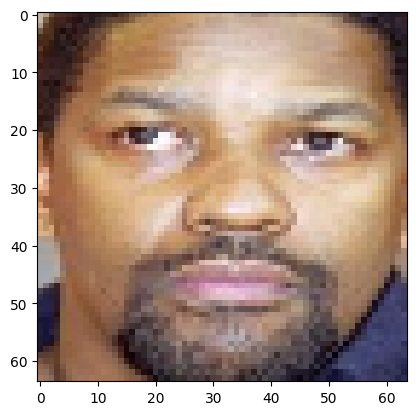

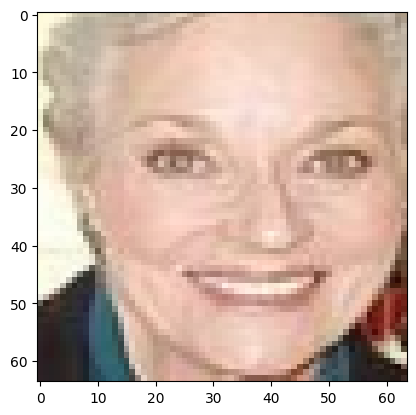

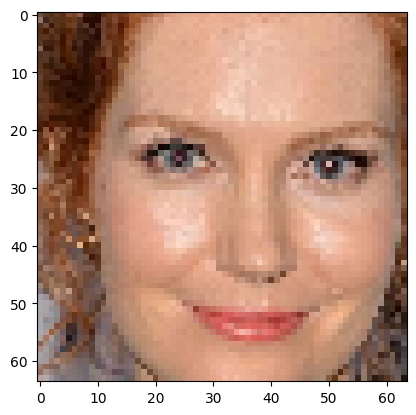

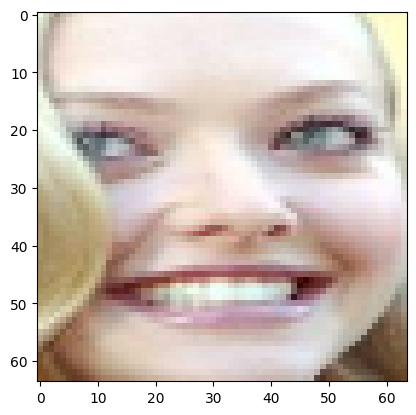

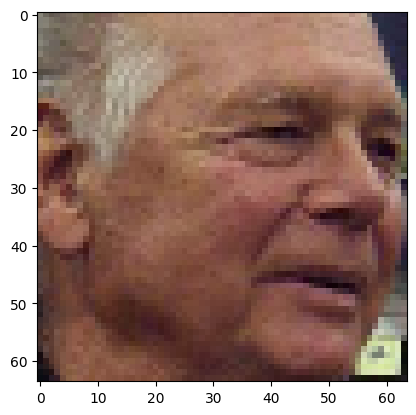

...

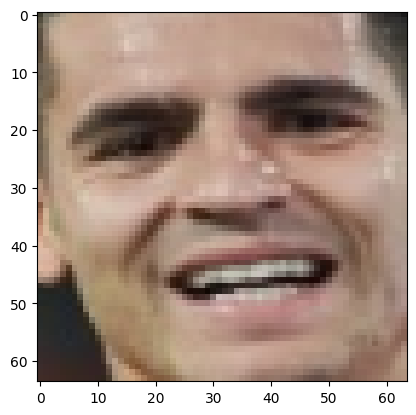

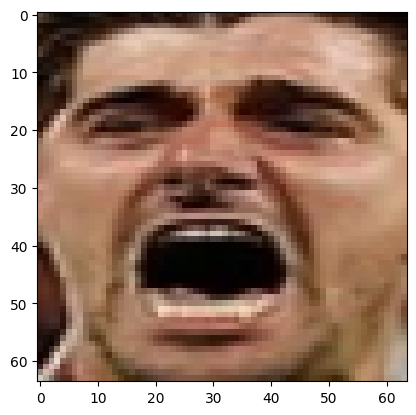

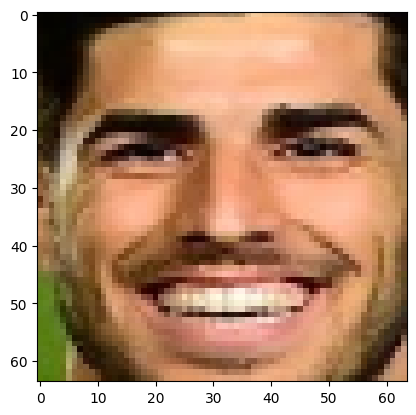

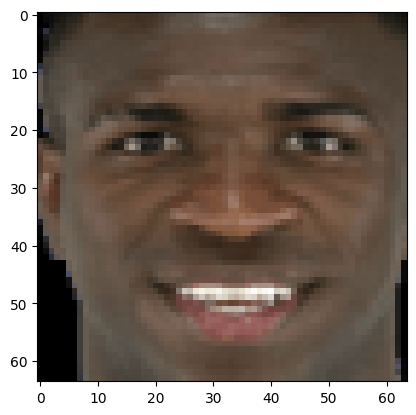

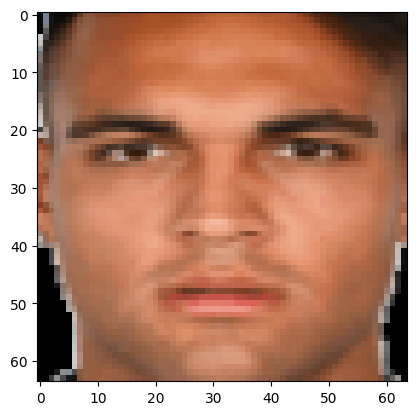

In [9]:
path = 'databaseCNN/NO_IBRA/'
images = os.listdir(path)

cut_faces_list = []

for image_path in images:
    # Obtener la ruta absoluta de la imagen
    abs_image_path = os.path.abspath(os.path.join(path, image_path))
    print(f'Cargando imagen: {abs_image_path}')

    # Cargar la imagen y detectar rostros
    image = cv2.cvtColor(cv2.imread(abs_image_path), cv2.COLOR_BGR2RGB)
    boxes = detect_faces(image)

    cut_faces = []
    for box in boxes:
        left, right, top, bottom = box
        face = image[top:bottom, left:right]
        cut_faces.append(cv2.resize(face,dsize=(64,64)))
    
    cut_faces_list.extend(cut_faces)

# Mostrar las imágenes recortadas
for i in range(len(cut_faces_list)):
    plt.figure(i)
    plt.imshow(cut_faces_list[i])

In [10]:
# Crea la carpeta NO_IBRA_CUT si no existe
if not os.path.exists('NO_IBRA_CUT'):
    os.makedirs('NO_IBRA_CUT')

# Guarda cada imagen en la carpeta IBRA_CUT
for i, cut_face in enumerate(cut_faces_list):
    # Guardar la imagen original
    filename = f'NO_IBRA_CUT/no_ibra_{i}.jpg'
    cv2.imwrite(filename, cv2.cvtColor(cut_face, cv2.COLOR_RGB2BGR))

# RED NEURONAL CONVOLUCIONAL

In [11]:
from skimage.io import imread_collection, concatenate_images
folderIbra = 'IBRA_CUT/*.jpg'
folderOthers = 'NO_IBRA_CUT/*.jpg'

# load data 
imagesIbra = imread_collection(folderIbra)
imagesOthers = imread_collection(folderOthers) 

# len
nIbra  = len(imagesIbra)
nOthers = len(imagesOthers)

# union data
images = np.append(imagesIbra,imagesOthers,axis=0)

print("Total de imagenes: ",len(images))

Total de imagenes:  1047


In [12]:
from skimage.transform import resize
def Create_Y():
     return [0]*nIbra + [1]*nOthers
# Aplicar etiquetas a cada clase
Y = Create_Y()

Y = np.array(Y)
X = np.array(images)

(64, 64, 3)


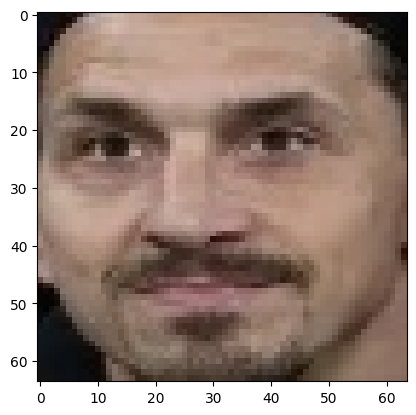

In [13]:
plt.imshow(X[0])
print(X[0].shape)

In [14]:
from sklearn.utils.multiclass import unique_labels
from keras.utils import to_categorical

#Ya que tenemos 2 clases debemos esperar que shape[1] de y_train,y_val y y_test cambie de 0 a 1
Y=to_categorical(Y)
Y[0]
Y[len(Y)-1]


array([0., 1.], dtype=float32)

In [15]:
from sklearn.model_selection import train_test_split
#X_train: Conjunto de entrenamiento que contiene las imágenes utilizadas para entrenar el modelo.
#Y_train: Etiquetas correspondientes al conjunto de entrenamiento.
#X_test: Conjunto de prueba que contiene las imágenes utilizadas para evaluar el rendimiento del modelo.
#Y_test: Etiquetas correspondientes al conjunto de prueba.

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3, random_state = 0)

In [171]:
# Crear la arquitectura de la CNN
from keras.models import Sequential
from keras.layers import Dense,Activation,Flatten,Dropout
from keras.layers import Conv2D,MaxPooling2D
from keras.callbacks import ModelCheckpoint

model=Sequential() #Varias capas apiladas entre ellas

#La primera capa de CNN seguida por las capas de Relu y MaxPooling
model.add(Conv2D(200,(3,3),input_shape=X.shape[1:]))#200 filtros de convolucion
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))

#La segunda capa de convolución seguida por las capas de Relu y MaxPooling
model.add(Conv2D(100,(3,3)))#100 filtros de convolucion
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))

#La tercera capa de convolución seguida por las capas de Relu y MaxPooling
model.add(Conv2D(50,(3,3)))#50 filtros de convolucion
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Flatten()) #Capa de aplanamiento para convertir los datos de imagen en un vector unidimensional

model.add(Dropout(0.5)) # Apagamos 50% de las neuronas cada paso, asi evitamos sobreajustar

#Capa Densa de 50 neuronas
model.add(Dense(50,activation='relu'))

#Capa de salida densa con 2 neuronas (asumiendo un problema de clasificación binaria)
model.add(Dense(2,activation='softmax'))

# Compilar y entrenar el modelo
model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
history = model.fit(X_train,Y_train,epochs=20,validation_split=0.2)

Epoch 1/20
18/18 [==============================] - 8s 385ms/step - loss: 5.6141 - accuracy: 0.5183 - val_loss: 0.5770 - val_accuracy: 0.7222
Epoch 2/20
18/18 [==============================] - 7s 388ms/step - loss: 0.7326 - accuracy: 0.5567 - val_loss: 0.8002 - val_accuracy: 0.4653
Epoch 3/20
18/18 [==============================] - 7s 369ms/step - loss: 0.6944 - accuracy: 0.5689 - val_loss: 0.6913 - val_accuracy: 0.6597
Epoch 4/20
18/18 [==============================] - 7s 362ms/step - loss: 0.6367 - accuracy: 0.6736 - val_loss: 0.6161 - val_accuracy: 0.5972
Epoch 5/20
18/18 [==============================] - 7s 362ms/step - loss: 0.5802 - accuracy: 0.6981 - val_loss: 0.5967 - val_accuracy: 0.7292
Epoch 6/20
18/18 [==============================] - 7s 369ms/step - loss: 0.5542 - accuracy: 0.7312 - val_loss: 0.5454 - val_accuracy: 0.7917
Epoch 7/20
18/18 [==============================] - 7s 369ms/step - loss: 0.5657 - accuracy: 0.7435 - val_loss: 0.5199 - val_accuracy: 0.7917
Epoch 

In [172]:
loss, accuracy = model.evaluate(X_test, Y_test)

# Mostrar la precisión
print("Precisión del modelo: {:.2f}%".format(accuracy * 100))

10/10 [==============================] - 1s 92ms/step - loss: 0.4187 - accuracy: 0.8506
Precisión del modelo: 85.06%


10/10 [==============================] - 1s 93ms/step


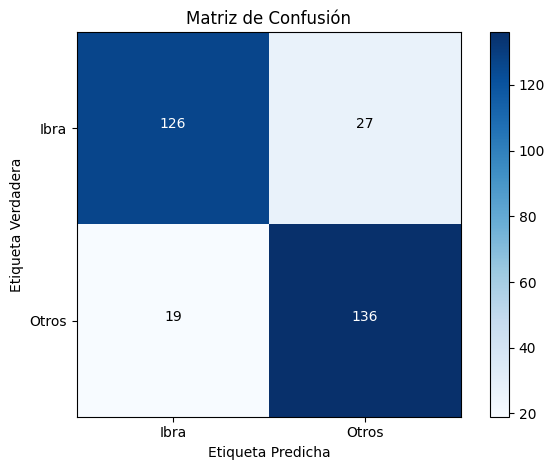

In [173]:
from sklearn.metrics import confusion_matrix

# Obtener las probabilidades de predicción
y_pred_probs = model.predict(X_test)

# Obtener las etiquetas predichas
y_pred = np.argmax(y_pred_probs, axis=1)

# Obtener las etiquetas verdaderas
y_true = np.argmax(Y_test, axis=1)

# Calcular la matriz de confusión
confusion_mtx = confusion_matrix(y_true, y_pred)

# Mostrar la matriz de confusión
plt.imshow(confusion_mtx, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Matriz de Confusión')
plt.colorbar()
tick_marks = np.arange(2)
plt.xticks(tick_marks, ['Ibra', 'Otros'])
plt.yticks(tick_marks, ['Ibra', 'Otros'])
plt.xlabel('Etiqueta Predicha')
plt.ylabel('Etiqueta Verdadera')

# Agregar los valores de los elementos de la matriz de confusión en cada celda
thresh = confusion_mtx.max() / 2.
for i in range(confusion_mtx.shape[0]):
    for j in range(confusion_mtx.shape[1]):
        plt.text(j, i, format(confusion_mtx[i, j], 'd'),
                 horizontalalignment="center",
                 color="white" if confusion_mtx[i, j] > thresh else "black")

plt.tight_layout()
plt.show()

1/1 [==============================] - 0s 21ms/step
[[0.9653096  0.03469035]]
Predicted label: IBRA


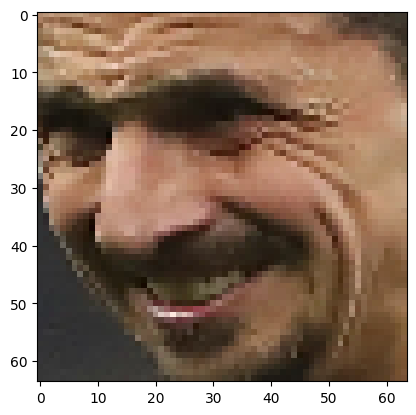

In [146]:
image = cv2.cvtColor(cv2.imread('prueba/ibra.jpeg'), cv2.COLOR_BGR2RGB)
boxes = detect_faces(image)
cut_faces = []
for box in boxes:
    left, right, top, bottom = box
    face = image[top:bottom, left:right]        
    image = cv2.resize(face,dsize=(64,64))
plt.imshow(image)
image = np.expand_dims(image, axis=0)
# Hacer prediccion
predictions = model.predict(image)
print(predictions)

# Obtener la clase predicha
predicted_class = np.argmax(predictions[0])
class_labels = ['IBRA', 'NO_IBRA']
predicted_label = class_labels[predicted_class]

print('Predicted label:', predicted_label)

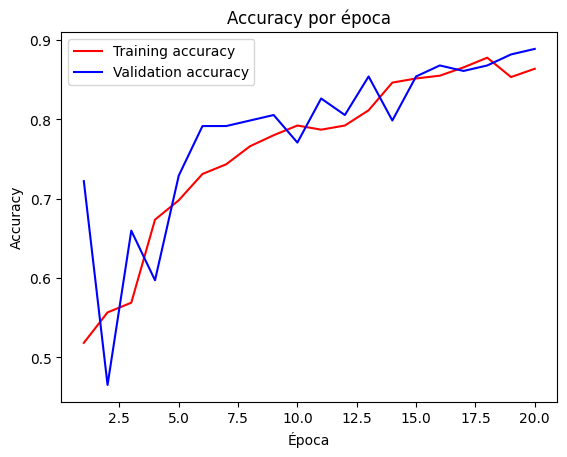

In [174]:
# Obtener los valores de precisión y pérdida del historial del entrenamiento
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
epochs = range(1, len(accuracy) + 1)

# Graficar la precisión por época
plt.plot(epochs, accuracy, 'r', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Accuracy por época')
plt.xlabel('Época')
plt.ylabel('Accuracy')
plt.legend()
plt.show()